In [1]:
import numpy as np
from matplotlib import pyplot as plt

import glob
from astropy.io import fits

%matplotlib inline
#%config InlineBackend.figure_format='retina'
#!pip install git+https://github.com/M-Bianchi/My_matplotlib_style
plt.style.use('mystyle')

In [2]:
path_20241028 = "Data/20241028/"
filenames_20241028 = glob.glob(path_20241028 + '*fit')

In [3]:
path_20241029 = "Data/20241029/"
filenames_20241029 = glob.glob(path_20241029 + '*fit')

In [4]:
path_20241030 = "Data/20241030/"
filenames_20241030 = glob.glob(path_20241030 + '*fit')

In [5]:
# If you execute this function with 'open' and then with 'create', you will get the error:
# PermissionError: [WinError 32] The process cannot access the file because it is being used by another process.
# I don't know how to fix it, but it's not a big deal. 

def open_fits(cmd, filepath, plot, func, args):
    if cmd == 'create':
        file = func(*args)
        hdu_out = fits.PrimaryHDU(file)
        hdu_out.writeto(filepath, overwrite=True)
        if plot == True:
            plt.imshow(file, clim=np.quantile(file, [0.01, 0.99]), cmap='gnuplot2', origin='lower')
            plt.colorbar(fraction=0.0375, pad=0.02);
        return file
    
    elif cmd == 'open':
        file_temp = fits.open(filepath)
        file = file_temp[0].data
        file_temp.close()
        if plot == True:
            plt.imshow(file, clim=np.quantile(file, [0.01, 0.99]), cmap='gnuplot2', origin='lower')
            plt.colorbar(fraction=0.0375, pad=0.02);
        return file

    else:
        print('Skipped')
        return None

# Bias frame

The bias is a frame with the telescope dome closed and zero exposure time.\
The result is not of zero counts, as one may expect, due to the fact that we are applying a baseline voltage to each pixel in order to be in the linear regime.\
It should be a constant baseline of counts (with an uncertainty given by the readout noise) that can be subtracted from the scientific image.\
We consider the median of multiple bias frames to reduce the uncertainty on the bias (thanks to Central Limit Theorem), which obviously is not removable by just subtracting the bias.

In [6]:
def get_bias(filenames, string):
    allbias = []

    for i, filename in enumerate (filenames):
        if(string in filenames[i]):
            mybias = fits.open(filename)
            allbias.append(mybias[0].data)
            mybias.close(filename)

    allbias = np.array(allbias)
    print('Number of biases =', allbias.shape[0])

    return np.median(allbias, axis=0)

Number of biases = 10


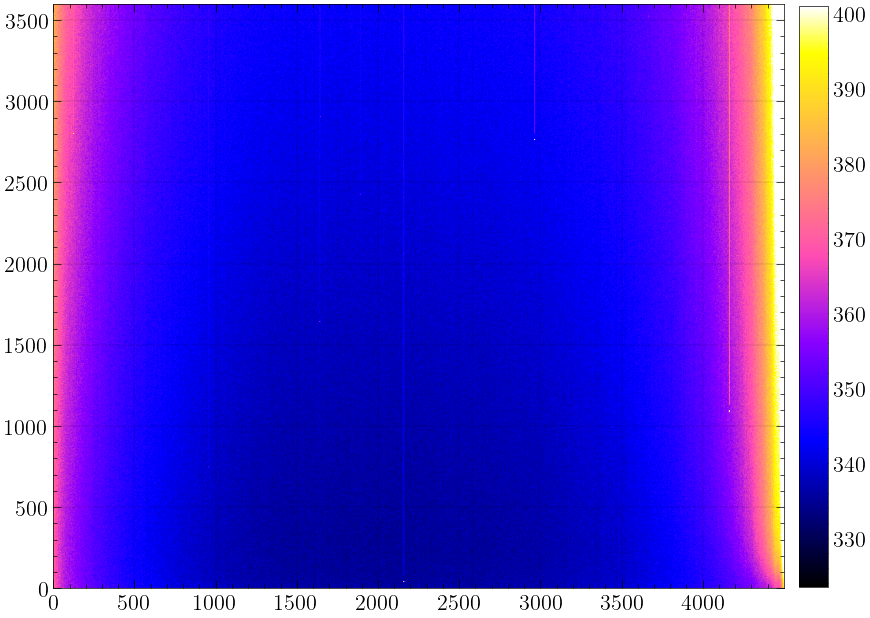

In [8]:
masterbias_20241028 = open_fits(cmd='create', filepath='Data/masterbias_20241028.fits', plot=True,
                                func=get_bias, args=[filenames_20241028, 'bias'])

Number of biases = 10


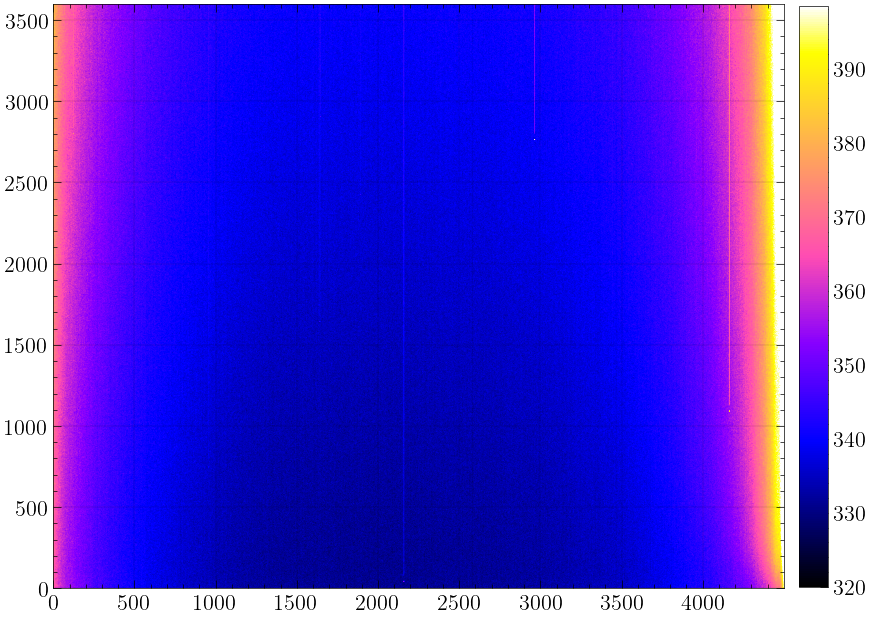

In [9]:
masterbias_20241029 = open_fits(cmd='create', filepath='Data/masterbias_20241029.fits', plot=True,
                                func=get_bias, args=[filenames_20241029, 'Bias'])

Number of biases = 15


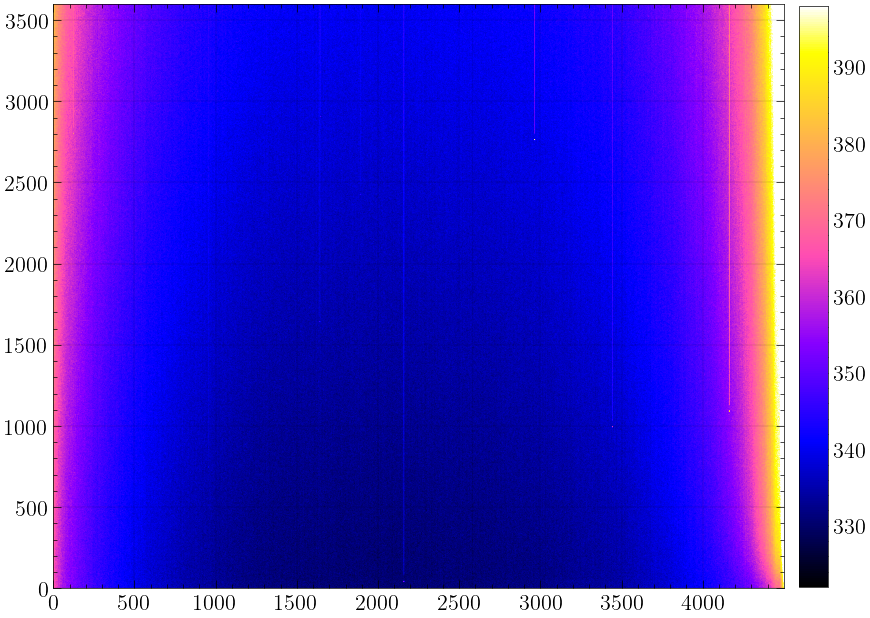

In [10]:
masterbias_20241030 = open_fits(cmd='create', filepath='Data/masterbias_20241030.fits', plot=True,
                                func=get_bias, args=[filenames_20241030, 'bias'])

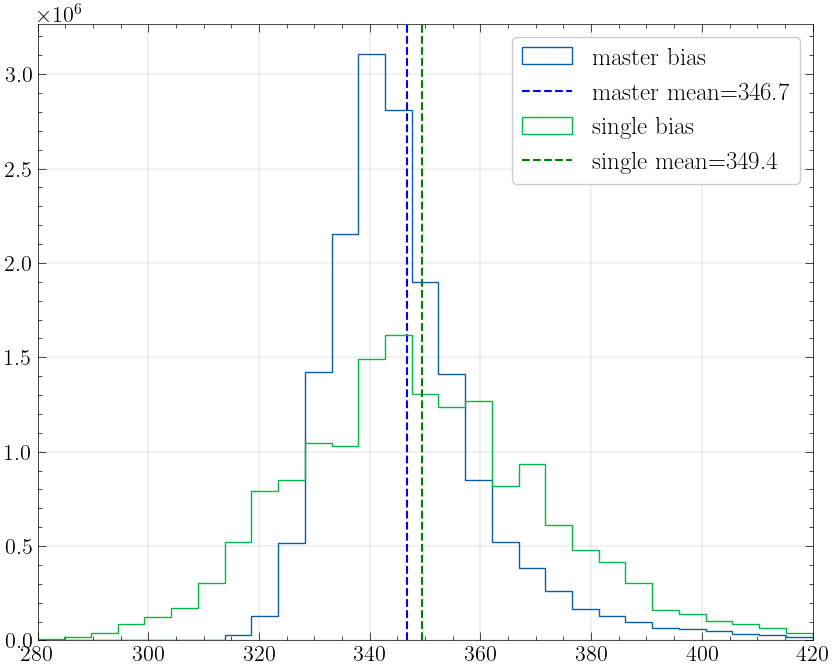

In [11]:
bias_bins = np.linspace(280, 420, 30)

plt.hist(masterbias_20241028.flatten(), bins=bias_bins, histtype='step', label='master bias')
plt.axvline(np.mean(masterbias_20241028), color='blue', linestyle='--', label=f'master mean={np.mean(masterbias_20241028):.1f}')

single_bias = fits.open('Data/20241028/Calib_000bias_m20.fit')[0].data
plt.hist(single_bias.flatten(), bins=bias_bins, histtype='step', label='single bias')
plt.axvline(np.mean(single_bias), color='green', linestyle='--', label=f'single mean={np.mean(single_bias):.1f}')

plt.xlim(280, 420)
plt.legend();

# Dark frame

We read the detector after some time of no light going in, measuring the dark current counts (+ the bias, of course).\
We can repeat the measure for different exposure times, obtaining a curve of the dark current counts as a function of the exposure time.

$\text{Science}_\text{corrected} = \left[ \text{Science} - \left(\text{Dark} - \text{Bias}\right) \dfrac{\Delta t_\text{Science}}{\Delta t_\text{Dark}} - \text{Bias} \right] {\huge/} \text{Flat}$ 

In [12]:
def get_dark(filenames, masterbias, string):
    alldark = []

    for i, filename in enumerate (filenames):
        if(string in filenames[i]):
            mydark = fits.open(filename)
            alldark.append(mydark[0].data - masterbias)
            mydark.close(filename)

    alldark = np.array(alldark)
    print('Number of darks =', alldark.shape[0])

    return np.median(alldark, axis=0)

Number of darks = 10


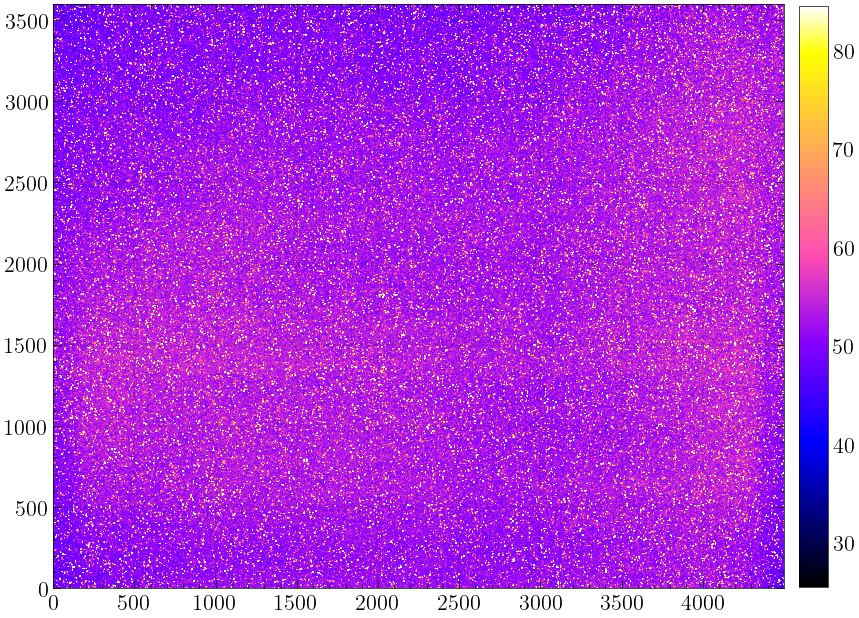

In [13]:
masterdark_20241030_1200 = open_fits(cmd='create', filepath='Data/masterdark_20241030_1200.fits', plot=True,
                                     func=get_dark, args=[filenames_20241030, masterbias_20241030, 'dark1200'])

# Flat frame

Not all the pixels have the same response. Often the edges of the detector are less responsive. There may also be some dead columns, due to manufacturing faults or accidental damage.\
Moreover, dust is often present on the surface of the mirror. We would like to compensate for these inhomogeneities.\
One way to produce a flat is to observe the sky at sunset, assuming a uniform flux. Another way is to use a lamp (this is what we will do).\
The bias must be subtracted from the flat frames, while the dark current is negligible due to the very short exposure time.\
The flat must be normalized such that its average value is one.

In [17]:
def get_flat(filenames, masterbias, masterdark, t_exp_dark, string):
    allflat = []
    
    for i, filename in enumerate (filenames):
        if(string in filenames[i]):
            myflat = fits.open(filename)
            myflat_t_exp = myflat[0].header['EXPTIME']
            allflat.append(myflat[0].data - masterdark*(myflat_t_exp/t_exp_dark) - masterbias)
            myflat.close(filename)
            
    allflat = np.array(allflat)
    print('Number of flats = ', allflat.shape[0])
    masterflat_temp = np.median(allflat, axis=0) 
        
    return (masterflat_temp) / np.mean(masterflat_temp)

Number of flats =  5
Number of flats =  5
Number of flats =  5
Number of flats =  5


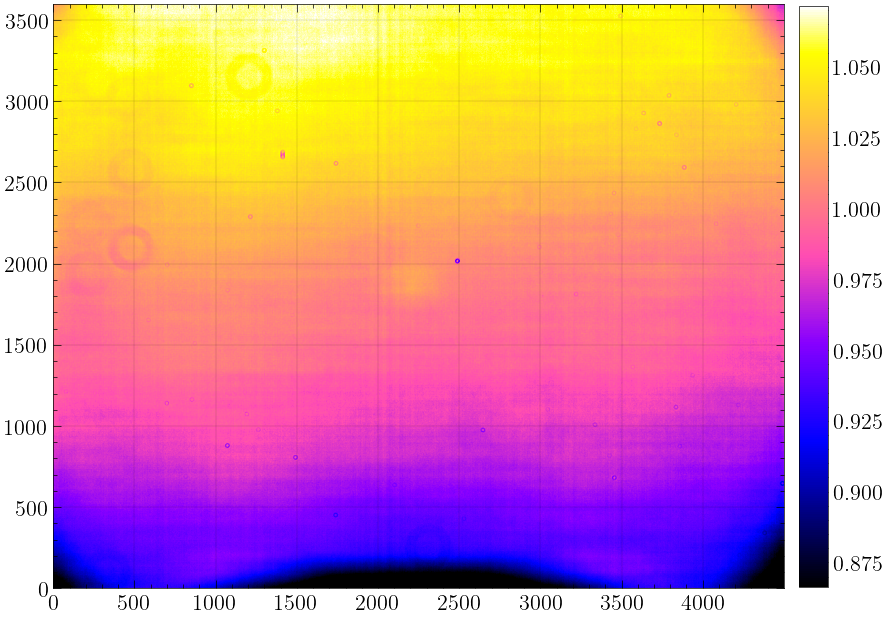

In [18]:
masterflat_20241028_g = open_fits(cmd='create', filepath='Data/masterflat_20241028_g.fits', plot=False,
                                  func=get_flat, args=[filenames_20241028, masterbias_20241028, masterdark_20241030_1200, 1200, 'flat_m20_g'])

masterflat_20241028_r = open_fits(cmd='create', filepath='Data/masterflat_20241028_r.fits', plot=False,
                                  func=get_flat, args=[filenames_20241028, masterbias_20241028, masterdark_20241030_1200, 1200, 'flat_m20_r'])

masterflat_20241028_i = open_fits(cmd='create', filepath='Data/masterflat_20241028_i.fits', plot=True,
                                  func=get_flat, args=[filenames_20241028, masterbias_20241028, masterdark_20241030_1200, 1200, 'flat_m20_i'])

masterflat_20241028_Ha = open_fits(cmd='create', filepath='Data/masterflat_20241028_Ha.fits', plot=False,
                                   func=get_flat, args=[filenames_20241028, masterbias_20241028, masterdark_20241030_1200, 1200, 'flat_m20_Ha'])

Number of flats =  5


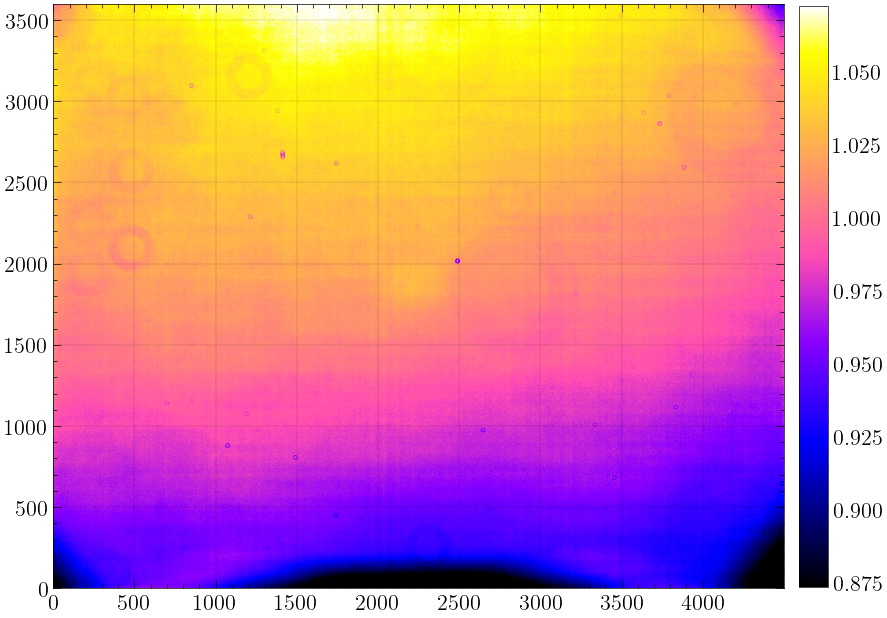

In [19]:
masterflat_20241029_Ha = open_fits(cmd='create', filepath='Data/masterflat_20241029_Ha.fits', plot=True,
                                   func=get_flat, args=[filenames_20241029, masterbias_20241029, masterdark_20241030_1200, 1200, 'flat_Ha'])

Number of flats =  5


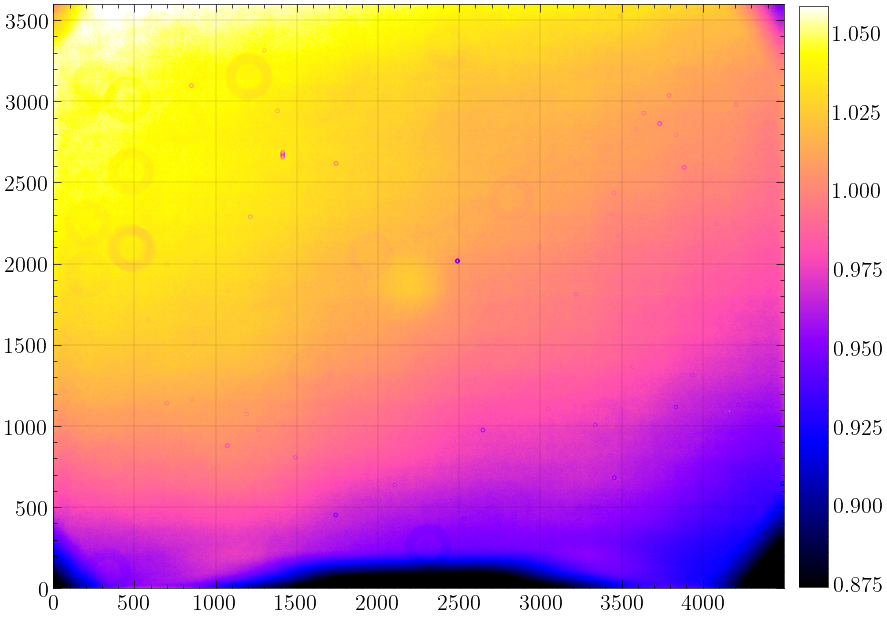

In [20]:
masterflat_20241030_Hb = open_fits(cmd='create', filepath='Data/masterflat_20241030_Hb.fits', plot=True,
                                   func=get_flat, args=[filenames_20241030, masterbias_20241030, masterdark_20241030_1200, 1200, 'flat_Hb'])

# Applying corrections

Our CCD has a gain of 0.6 electrons/count

In [21]:
gain = 0.6 #electrons/ADU

In [22]:
def get_science_image(filenames, masterbias, masterdark, masterflat, t_exp_dark, string):
    
    for i, filename in enumerate (filenames):
        if(string in filenames[i]):
            myscience = fits.open(filename)
            myscience_t_exp = myscience[0].header['EXPTIME']
            myscience_corrected = (myscience[0].data - masterdark*(myscience_t_exp/t_exp_dark) - masterbias) / masterflat
            myscience_corrected = myscience_corrected * gain / myscience_t_exp
            myscience.close(filename)
        
    return myscience_corrected

## g filter

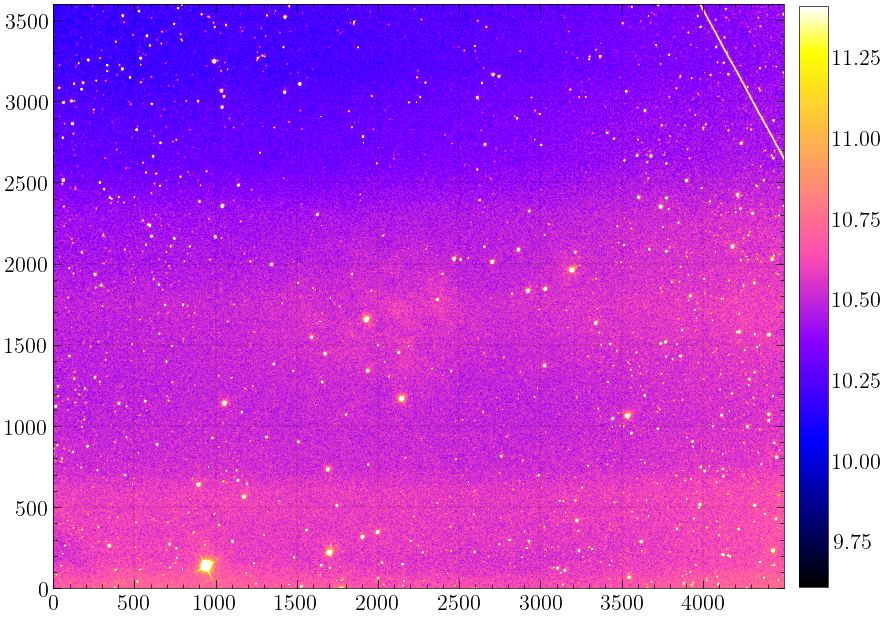

In [23]:
science_g_1 = open_fits(cmd='create', filepath='Data/science_g_1.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_g,
                                                      1200,
                                                      'IC5146_g_000'])

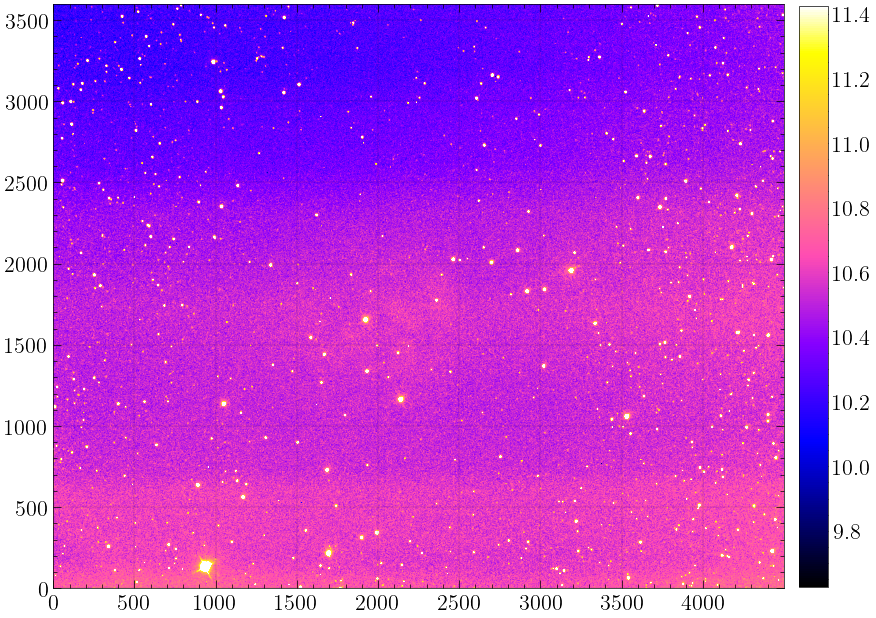

In [24]:
science_g_2 = open_fits(cmd='create', filepath='Data/science_g_2.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_g,
                                                      1200,
                                                      'IC5146_g_001'])

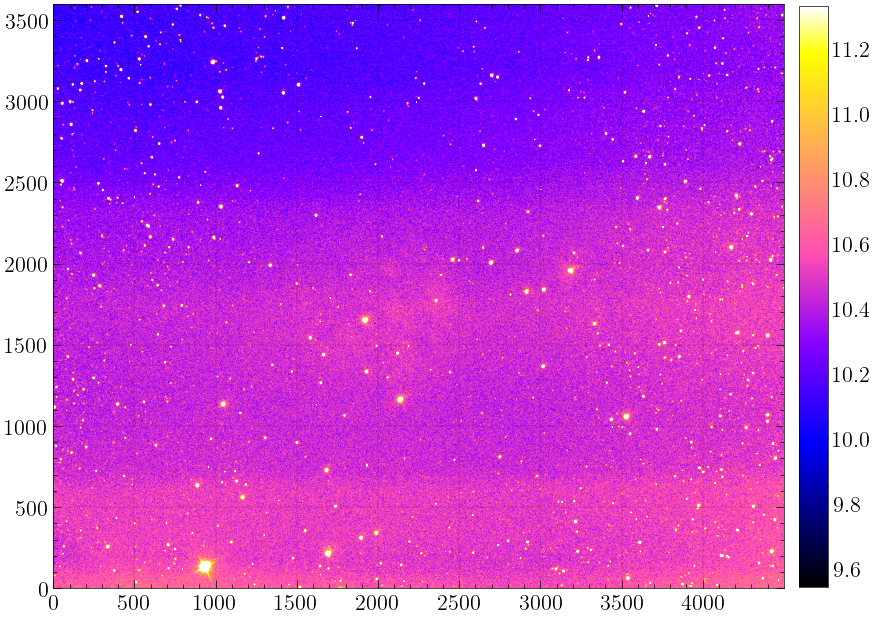

In [25]:
science_g_3 = open_fits(cmd='create', filepath='Data/science_g_3.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_g,
                                                      1200,
                                                      'IC5146_g_002'])

## r filter

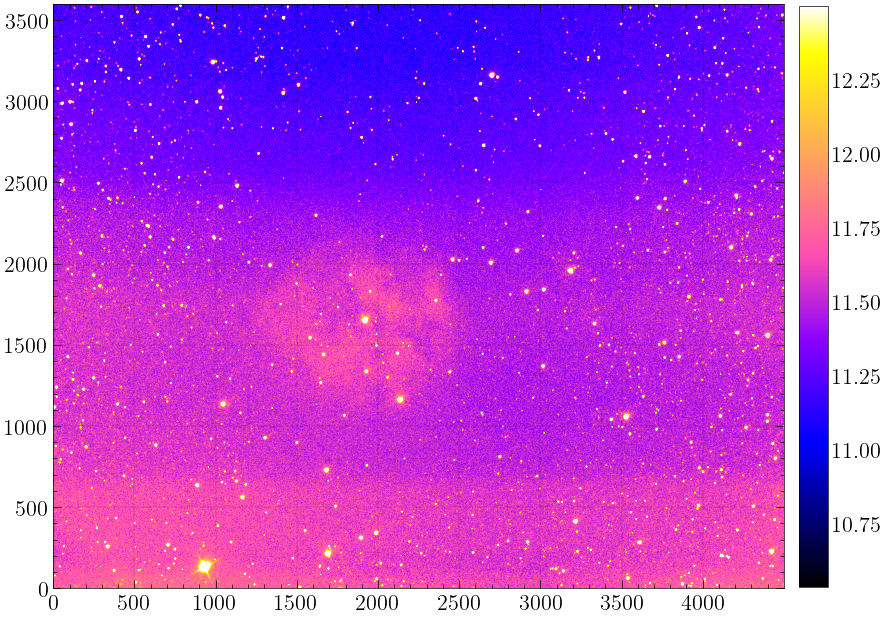

In [26]:
science_r_1 = open_fits(cmd='create', filepath='Data/science_r_1.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_r,
                                                      1200,
                                                      'IC5146_r_000'])

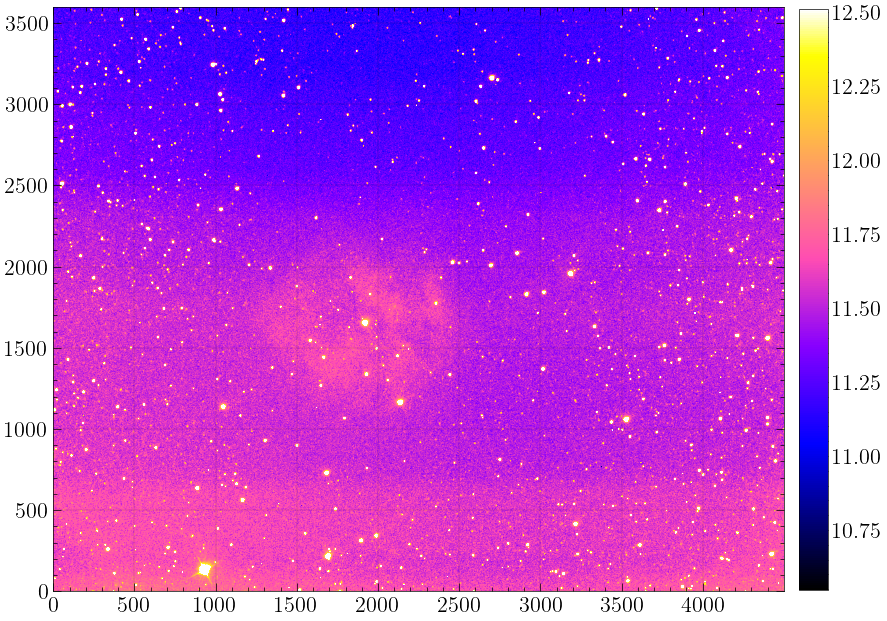

In [27]:
science_r_2 = open_fits(cmd='create', filepath='Data/science_r_2.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_r,
                                                      1200,
                                                      'IC5146_r_001'])

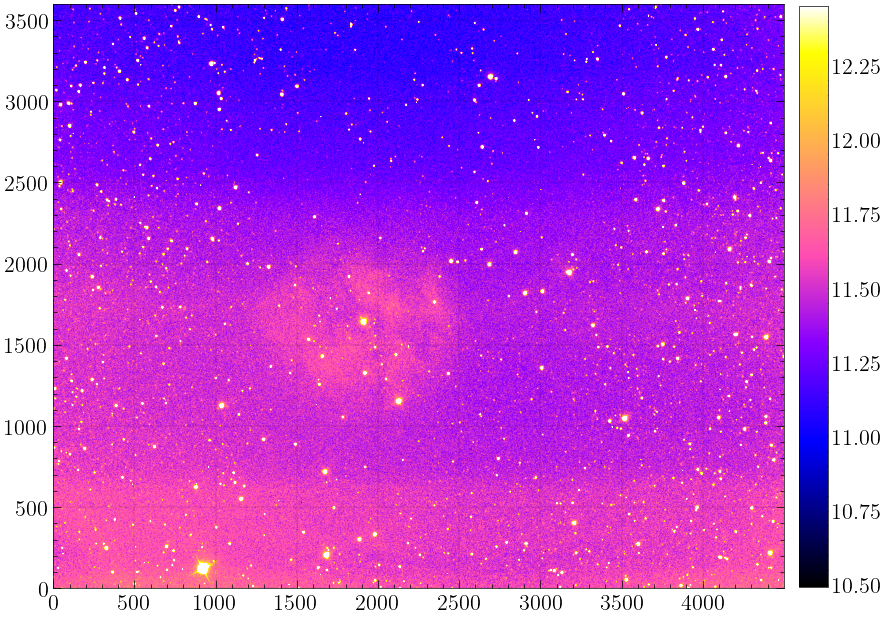

In [28]:
science_r_3 = open_fits(cmd='create', filepath='Data/science_r_3.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_r,
                                                      1200,
                                                      'IC5146_r_002'])

## i filter

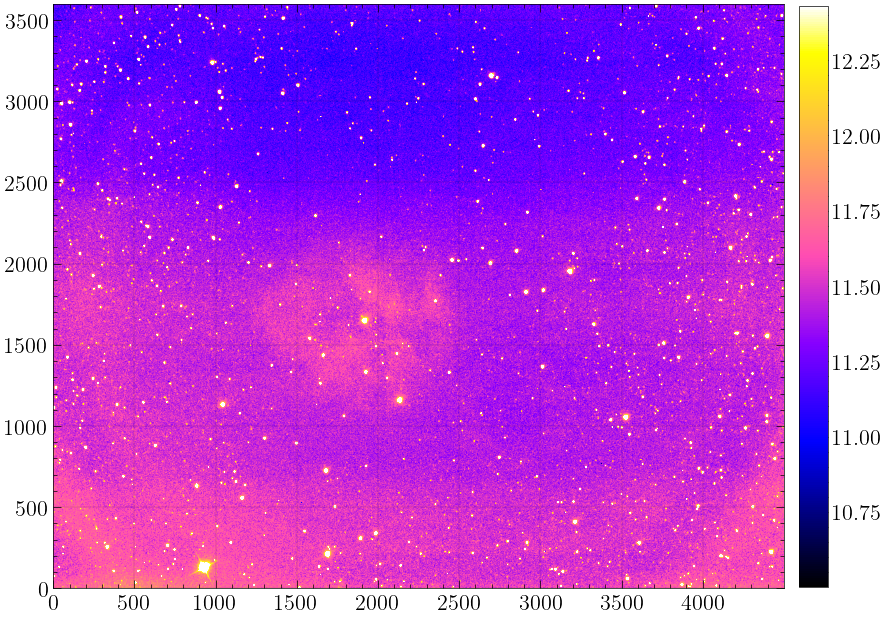

In [29]:
science_i_1 = open_fits(cmd='create', filepath='Data/science_i_1.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_i,
                                                      1200,
                                                      'IC5146_i_000'])

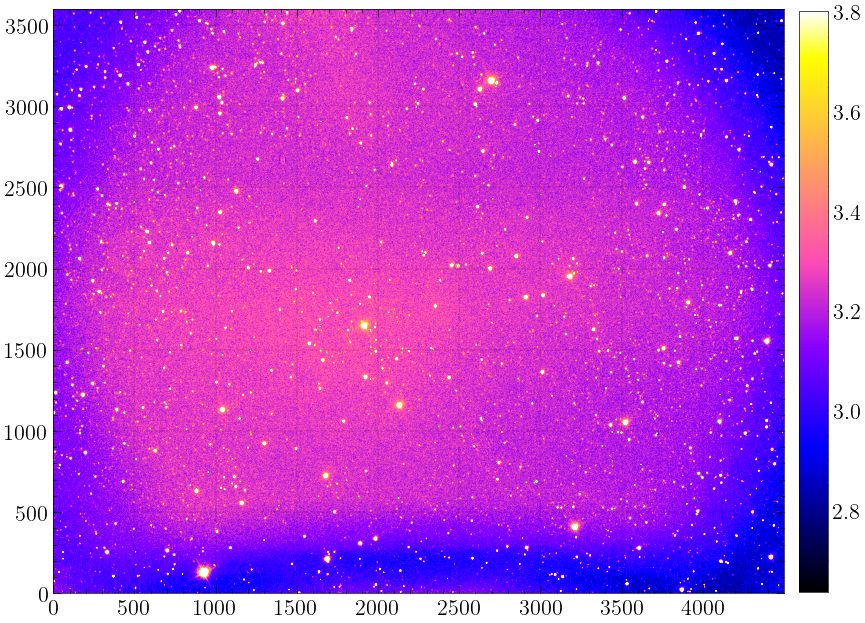

In [30]:
science_i_2 = open_fits(cmd='create', filepath='Data/science_i_2.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_i,
                                                      1200,
                                                      'IC5146_i_001'])

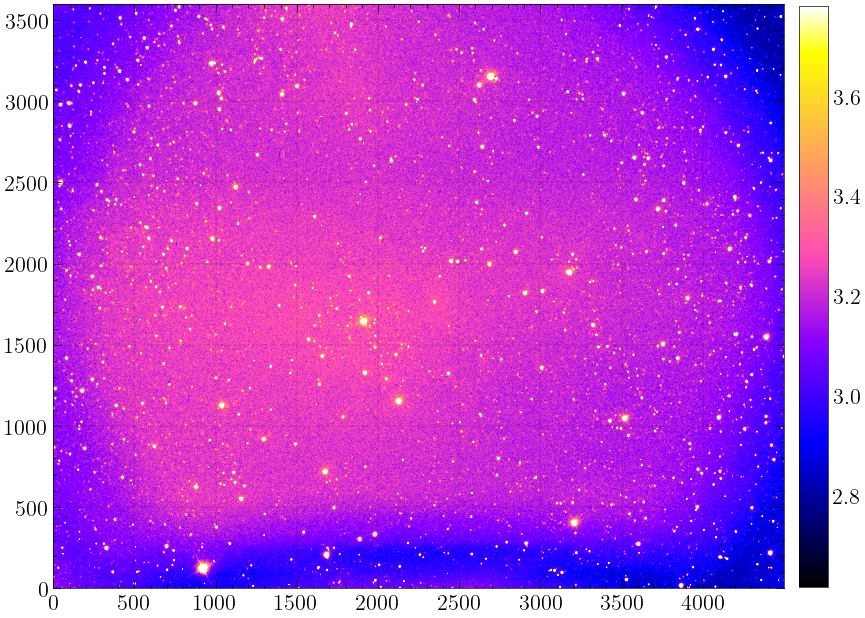

In [31]:
science_i_3 = open_fits(cmd='create', filepath='Data/science_i_3.fits', plot=True,
                        func=get_science_image, args=[filenames_20241028, 
                                                      masterbias_20241028, 
                                                      masterdark_20241030_1200, 
                                                      masterflat_20241028_i,
                                                      1200,
                                                      'IC5146_i_002'])

## Ha filter

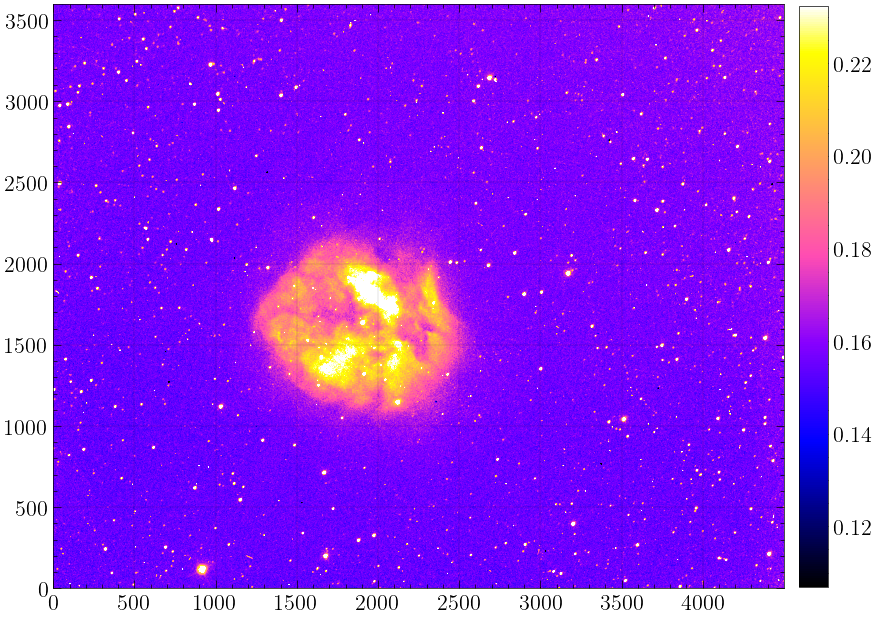

In [33]:
science_Ha_1 = open_fits(cmd='create', filepath='Data/science_Ha_1.fits', plot=True,
                         func=get_science_image, args=[filenames_20241028, 
                                                       masterbias_20241028, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241028_Ha,
                                                       1200,
                                                       'IC5146_Ha'])

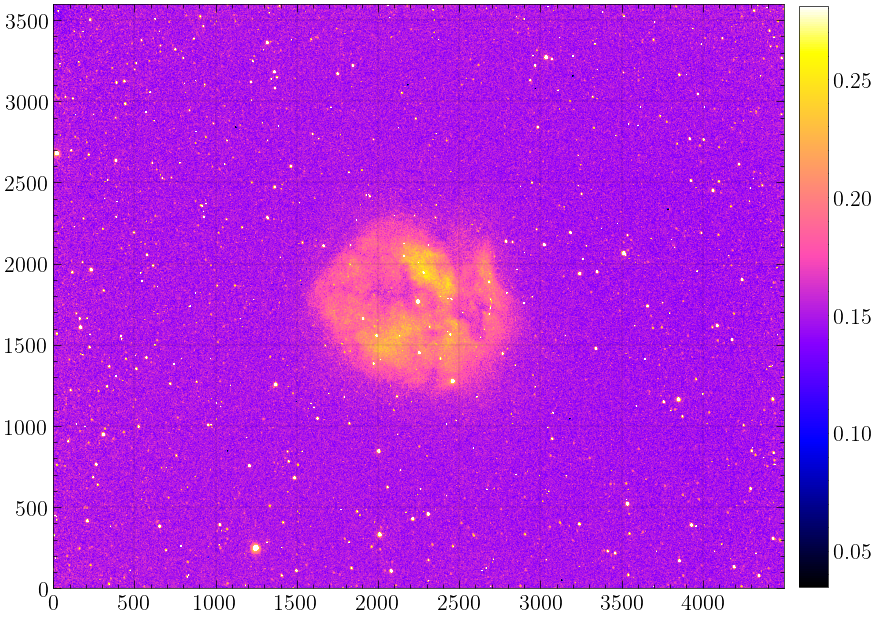

In [34]:
science_Ha_2 = open_fits(cmd='create', filepath='Data/science_Ha_2.fits', plot=False,
                         func=get_science_image, args=[filenames_20241029, 
                                                       masterbias_20241029, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241029_Ha,
                                                       1200,
                                                       'IC5146_Ha_047'])

# These images are rotated by 180 degrees
science_Ha_2 = np.rot90(np.rot90(science_Ha_2))

hdu_out = fits.PrimaryHDU(science_Ha_2)
hdu_out.writeto('Data/science_Ha_2.fits', overwrite=True)
hdu_out = []

plt.imshow(science_Ha_2, clim=np.quantile(science_Ha_2, [0.01, 0.99]), cmap='gnuplot2', origin='lower')
plt.colorbar(fraction=0.0375, pad=0.02);

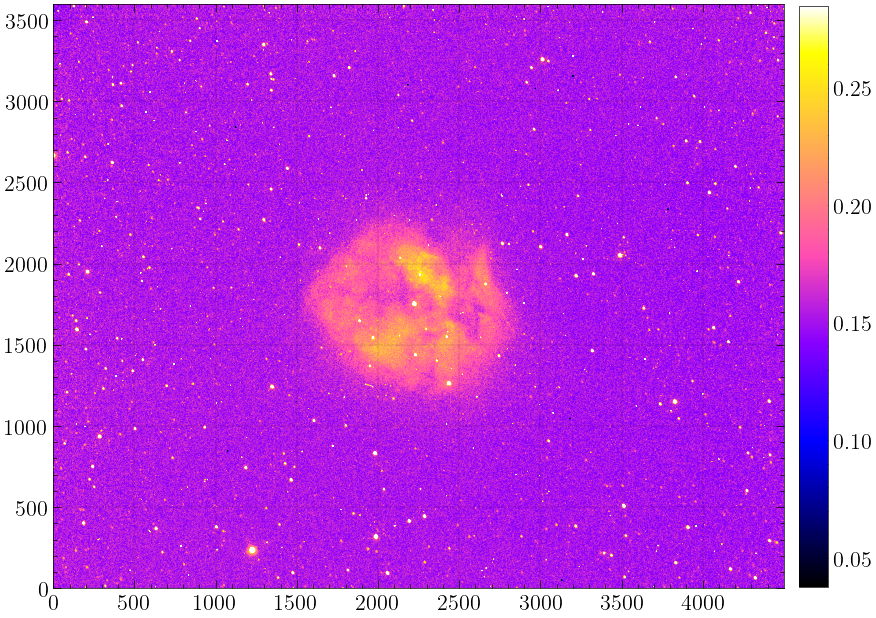

In [35]:
science_Ha_3 = open_fits(cmd='create', filepath='Data/science_Ha_3.fits', plot=False,
                         func=get_science_image, args=[filenames_20241029, 
                                                       masterbias_20241029, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241029_Ha,
                                                       1200,
                                                       'IC5146_Ha_048'])

# These images are rotated by 180 degrees
science_Ha_3 = np.rot90(np.rot90(science_Ha_3))

hdu_out = fits.PrimaryHDU(science_Ha_3)
hdu_out.writeto('Data/science_Ha_3.fits', overwrite=True)
hdu_out = []

plt.imshow(science_Ha_3, clim=np.quantile(science_Ha_3, [0.01, 0.99]), cmap='gnuplot2', origin='lower')
plt.colorbar(fraction=0.0375, pad=0.02);

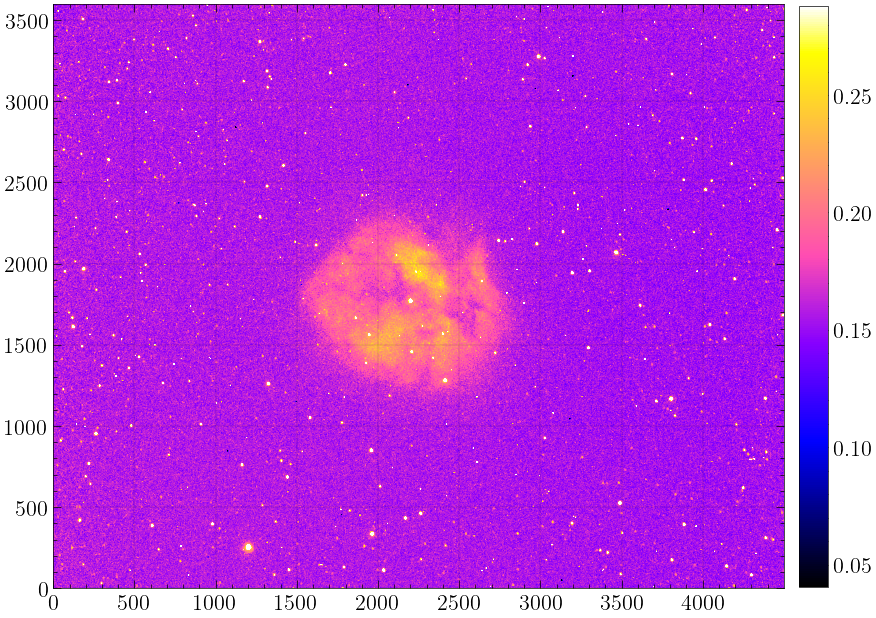

In [36]:
science_Ha_4 = open_fits(cmd='create', filepath='Data/science_Ha_4.fits', plot=False,
                         func=get_science_image, args=[filenames_20241029, 
                                                       masterbias_20241029, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241029_Ha,
                                                       1200,
                                                       'IC5146_Ha_049'])

# These images are rotated by 180 degrees
science_Ha_4 = np.rot90(np.rot90(science_Ha_4))

hdu_out = fits.PrimaryHDU(science_Ha_4)
hdu_out.writeto('Data/science_Ha_4.fits', overwrite=True)
hdu_out = []

plt.imshow(science_Ha_4, clim=np.quantile(science_Ha_4, [0.01, 0.99]), cmap='gnuplot2', origin='lower')
plt.colorbar(fraction=0.0375, pad=0.02);

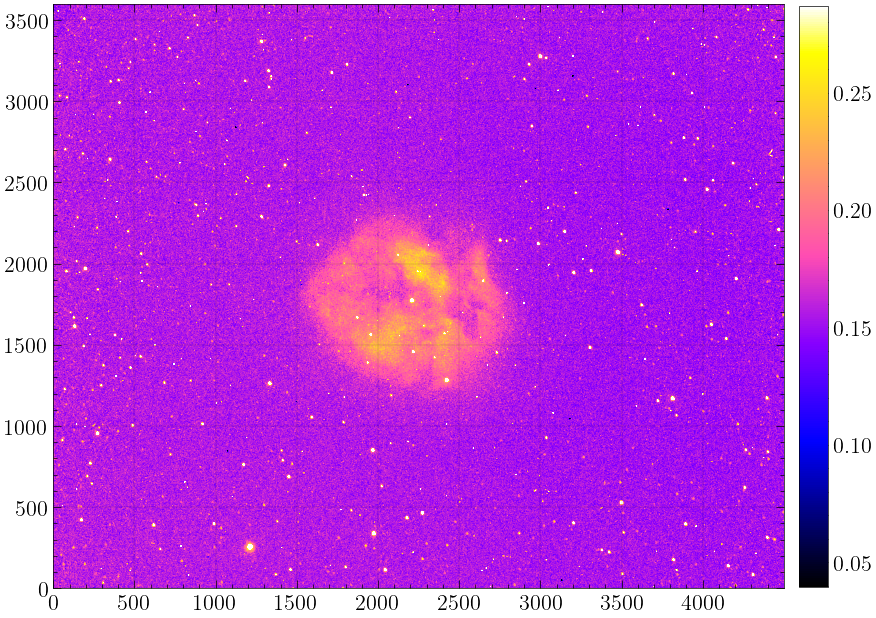

In [37]:
science_Ha_5 = open_fits(cmd='create', filepath='Data/science_Ha_5.fits', plot=False,
                         func=get_science_image, args=[filenames_20241029, 
                                                       masterbias_20241029, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241029_Ha,
                                                       1200,
                                                       'IC5146_Ha_050'])

# These images are rotated by 180 degrees
science_Ha_5 = np.rot90(np.rot90(science_Ha_5))

hdu_out = fits.PrimaryHDU(science_Ha_5)
hdu_out.writeto('Data/science_Ha_5.fits', overwrite=True)
hdu_out = []

plt.imshow(science_Ha_5, clim=np.quantile(science_Ha_5, [0.01, 0.99]), cmap='gnuplot2', origin='lower')
plt.colorbar(fraction=0.0375, pad=0.02);

## Hb filter

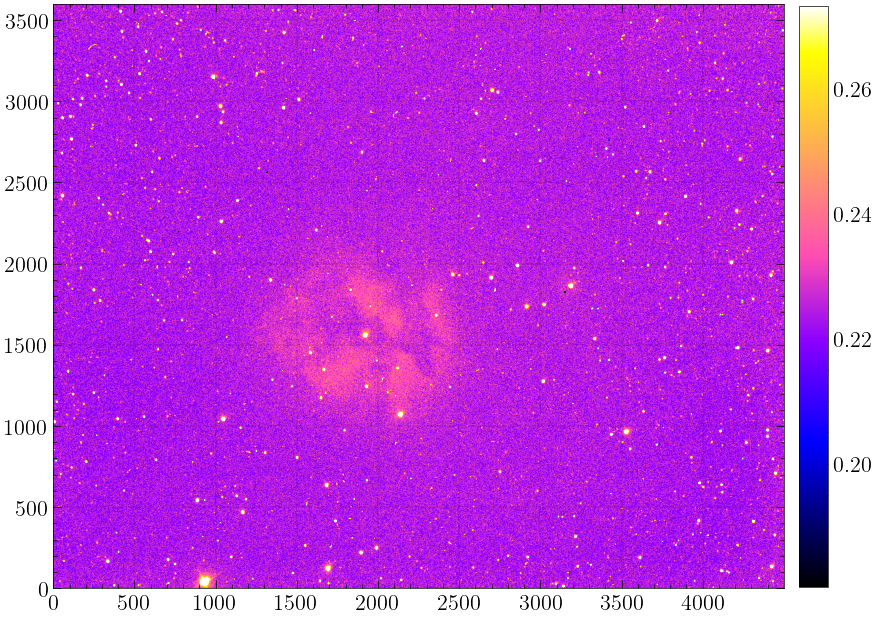

In [38]:
science_Hb_1 = open_fits(cmd='create', filepath='Data/science_Hb_1.fits', plot=True,
                         func=get_science_image, args=[filenames_20241030, 
                                                       masterbias_20241030, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241030_Hb,
                                                       1200,
                                                       'IC5146_Hb_1200_062'])

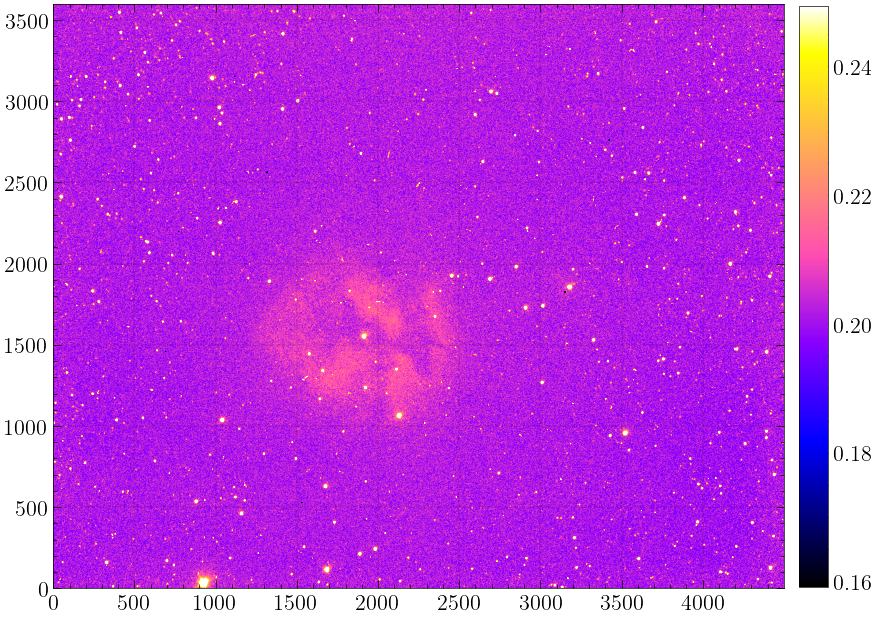

In [39]:
science_Hb_2 = open_fits(cmd='create', filepath='Data/science_Hb_2.fits', plot=True,
                         func=get_science_image, args=[filenames_20241030, 
                                                       masterbias_20241030, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241030_Hb,
                                                       1200,
                                                       'IC5146_Hb_1200_063'])

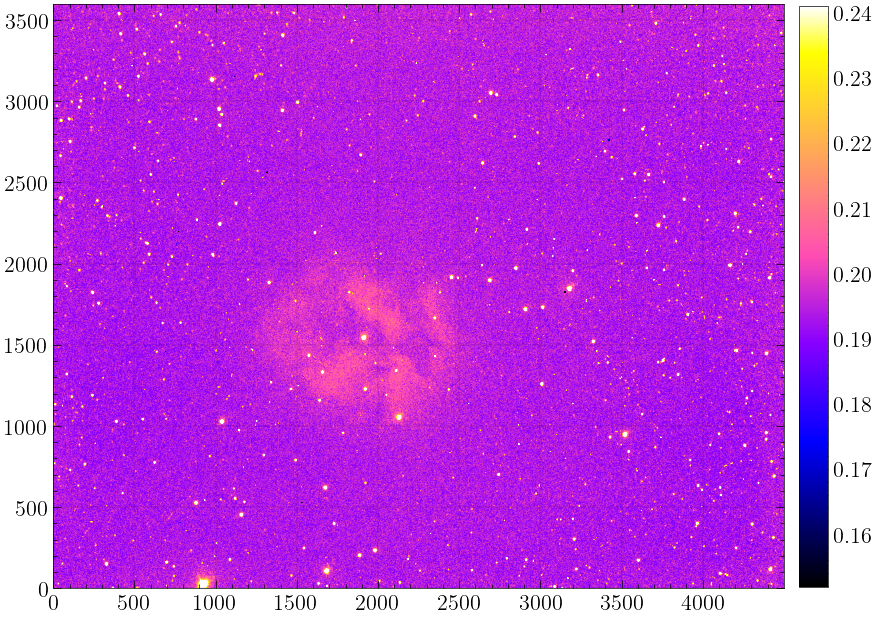

In [40]:
science_Hb_3 = open_fits(cmd='create', filepath='Data/science_Hb_3.fits', plot=True,
                         func=get_science_image, args=[filenames_20241030, 
                                                       masterbias_20241030, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241030_Hb,
                                                       1200,
                                                       'IC5146_Hb_1200_064'])

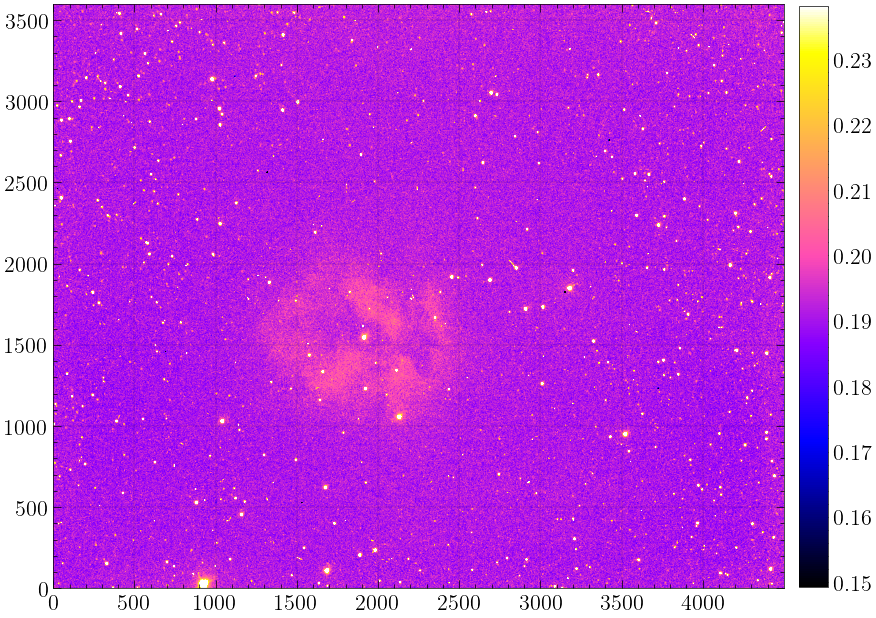

In [41]:
science_Hb_4 = open_fits(cmd='create', filepath='Data/science_Hb_4.fits', plot=True,
                         func=get_science_image, args=[filenames_20241030, 
                                                       masterbias_20241030, 
                                                       masterdark_20241030_1200, 
                                                       masterflat_20241030_Hb,
                                                       1200,
                                                       'IC5146_Hb_1200_065'])